<a href="https://colab.research.google.com/github/Freeskyadam/BI-Specialized-Bootcamp/blob/main/Time_Series_Advance_Tugas_Day_12_Frizky_Adam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install sktime[all_extras]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
#Load Package, Preprosesing, Tran & Test set,ETC
import datetime
import os
import numpy as np
import pandas as pd
import statsmodels.api as sm
import seaborn as sns
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot
from statsmodels.stats.diagnostic import acorr_ljungbox
import statsmodels.api as sm
from sktime.utils.plotting import plot_series 
from sktime.forecasting.naive import NaiveForecaster
from sktime.forecasting.arima import AutoARIMA
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.ets import AutoETS
from sktime.forecasting.tbats import TBATS
from sktime.forecasting.fbprophet import Prophet
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.model_selection import (
    temporal_train_test_split, 
    ExpandingWindowSplitter, 
    SlidingWindowSplitter
) 
from sktime.performance_metrics.forecasting import (
    mean_absolute_error, 
    mean_squared_error, 
    mean_absolute_percentage_error
) 
from sktime.forecasting.model_evaluation import evaluate
%matplotlib inline
import warnings
sns.set_style("ticks")
sns.set(font_scale = 1.5)
!pip install matplotlib==3.1.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached matplotlib-3.1.3-cp37-cp37m-manylinux1_x86_64.whl (13.1 MB)
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.5.2
    Uninstalling matplotlib-3.5.2:
      Successfully uninstalled matplotlib-3.5.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fbprophet 0.7.1 requires cmdstanpy==0.9.5, but you have cmdstanpy 0.9.68 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [3]:
import matplotlib.pyplot as plt
!pip install -U matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached matplotlib-3.5.2-cp37-cp37m-manylinux_2_5_x86_64.manylinux1_x86_64.whl (11.2 MB)
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.1.3
    Uninstalling matplotlib-3.1.3:
      Successfully uninstalled matplotlib-3.1.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fbprophet 0.7.1 requires cmdstanpy==0.9.5, but you have cmdstanpy 0.9.68 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


Time Series Forecasting - Advanced 60 poin

Divisi bisnis dari tribe Growth meminta anda untuk melakukan analisis terhadap transaksi yang terjadi di platform e-commerce secara harian dan anda juga diminta untuk melakukan forecasting yang mana hasil dari peramalan tersebut akan digunakan untuk menyusun strategi kedepannya. Berikut metadata dari data yang akan dianalisis:

'Row ID' - This is nothing but Serial No.

'Order ID' - ID created when a product order is placed.

'Order Date' - Date on which a customer places his/her order.

'Ship Date' - Date on which the order is shipped.

'Ship Mode' - Mode of shipment of each order.

'Customer ID' - ID assigned to each customer who places an order.

'Customer Name' - Name of Customer.

'Segment' - Section from where the order is placed.

'Country' - Country details of this data set. We are looking only for US store data.

'City' - Cities of US are listed here.

'State' - States of US are listed here.

'Postal Code' - pin code

'Region' - grouped into region wise

'Product ID' - Product ID of each product

'Category' - Category to which each product belongs to.

'Sub-Category' - Sub-Category of each Category

'Product Name' - Name of products.

'Sales' - Selling Price of each product.

'Quantity' - number of quantity available for a particular product.

'Discount' - Discount available on each product.

'Profit' - Profit gained on each product.


Hitunglah jumlah pembeli, jumlah transaksi, GMV, dan profit yang diperoleh dengan rentang waktu berikut: (poin 5)

Harian

Mingguan

Bulanan

Catatan: GMV dihitung berdasarkan total spending yang dilakukan customer dengan memperhitungkan semua biaya dan diskon yang dibayarkan customer
Hitunglah monthly retention dari kegiatan transaksi yang terjadi di dalam platform e-commerce. (Poin 10)

Catatan: Monthly retention dihitung berdasarkan jumlah customer yang kembali berbelanja setelah sebelumnya juga berbelanja di bulan sebelumnya
Identifikasi produk-produk apa saja yang membawa profit terbesar dalam 3 bulan terakhir (Poin 5)

Buatlah model forecasting menggunakan model yang sudah diajarkan pada materi day 12 untuk memprediksi jumlah visitor dan jumlah transaksi untuk 1 bulan kedepan dengan data harian. Anda diharuskan setidaknya membuat 2 model untuk selanjutnya diambil model terbaik berdasarkan MAPE terkecil. Berikan rekomendasi apa yang perlu dilakukan tim bisnis berdasarkan hasil forecasting dan analisis anda. (Poin 30)

Catatan: Perhatikan baik-baik data yang dianalisis, karena jika tidak anda bisa menghitung metrik bisnis dengan cara yang salah.


In [4]:
pd.set_option("max_columns",None)
pd.set_option("max_rows",None)
df = pd.read_csv("https://raw.githubusercontent.com/hadimaster65555/dataset_for_teaching/main/dataset/time_series_data/superstore_time_series_dataset/superstore_train.csv", parse_dates=['Order Date'],)

In [5]:
df

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,State,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit
0,1,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,2,0.00,41.9136
1,2,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,3,0.00,219.5820
2,3,CA-2016-138688,2016-06-12,2016-06-16,Second Class,DV-13045,Darrin Van Huff,Corporate,United States,Los Angeles,California,90036,West,OFF-LA-10000240,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,2,0.00,6.8714
3,4,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.0310
4,5,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,OFF-ST-10000760,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2,0.20,2.5164
5,6,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,FUR-FU-10001487,Furniture,Furnishings,Eldon Expressions Wood and Plastic Desk Access...,48.8600,7,0.00,14.1694
6,7,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AR-10002833,Office Supplies,Art,Newell 322,7.2800,4,0.00,1.9656
7,8,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,TEC-PH-10002275,Technology,Phones,Mitel 5320 IP Phone VoIP phone,907.1520,6,0.20,90.7152
8,9,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-BI-10003910,Office Supplies,Binders,DXL Angle-View Binders with Locking Rings by S...,18.5040,3,0.20,5.7825
9,10,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AP-10002892,Office Supplies,Appliances,Belkin F5C206VTEL 6 Outlet Surge,114.9000,5,0.00,34.4700


In [6]:
df[df["Order Date"]=='2017-12-12T00:00:00.000000000']

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,State,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit


In [7]:
df.isnull().sum()

Row ID           0
Order ID         0
Order Date       0
Ship Date        0
Ship Mode        0
Customer ID      0
Customer Name    0
Segment          0
Country          0
City             0
State            0
Postal Code      0
Region           0
Product ID       0
Category         0
Sub-Category     0
Product Name     0
Sales            0
Quantity         0
Discount         0
Profit           0
dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Row ID         8000 non-null   int64         
 1   Order ID       8000 non-null   object        
 2   Order Date     8000 non-null   datetime64[ns]
 3   Ship Date      8000 non-null   object        
 4   Ship Mode      8000 non-null   object        
 5   Customer ID    8000 non-null   object        
 6   Customer Name  8000 non-null   object        
 7   Segment        8000 non-null   object        
 8   Country        8000 non-null   object        
 9   City           8000 non-null   object        
 10  State          8000 non-null   object        
 11  Postal Code    8000 non-null   int64         
 12  Region         8000 non-null   object        
 13  Product ID     8000 non-null   object        
 14  Category       8000 non-null   object        
 15  Sub-Category   8000 n

In [9]:
df["Order Date"] = pd.to_datetime(df["Order Date"],format="%Y-%m-%d")
df["Ship Date"] = pd.to_datetime(df["Ship Date"])

In [10]:
for x in df.columns:
  print(f"unique {x}")
  print(f"{df[x].unique()}")
  print()

unique Row ID
[   1    2    3 ... 7998 7999 8000]

unique Order ID
['CA-2016-152156' 'CA-2016-138688' 'US-2015-108966' ... 'US-2015-165743'
 'US-2017-105998' 'US-2014-148194']

unique Order Date
['2016-11-08T00:00:00.000000000' '2016-06-12T00:00:00.000000000'
 '2015-10-11T00:00:00.000000000' ... '2014-05-31T00:00:00.000000000'
 '2014-01-03T00:00:00.000000000' '2016-07-20T00:00:00.000000000']

unique Ship Date
['2016-11-11T00:00:00.000000000' '2016-06-16T00:00:00.000000000'
 '2015-10-18T00:00:00.000000000' ... '2017-07-30T00:00:00.000000000'
 '2016-04-30T00:00:00.000000000' '2014-05-07T00:00:00.000000000']

unique Ship Mode
['Second Class' 'Standard Class' 'First Class' 'Same Day']

unique Customer ID
['CG-12520' 'DV-13045' 'SO-20335' 'BH-11710' 'AA-10480' 'IM-15070'
 'HP-14815' 'PK-19075' 'AG-10270' 'ZD-21925' 'KB-16585' 'SF-20065'
 'EB-13870' 'EH-13945' 'TB-21520' 'MA-17560' 'GH-14485' 'SN-20710'
 'LC-16930' 'RA-19885' 'ES-14080' 'ON-18715' 'PO-18865' 'LH-16900'
 'DP-13000' 'JM-15265'

In [11]:
df['GMV'] = df["Quantity"]*(df["Sales"] - df["Discount"]*df['Sales'])
df

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,State,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,GMV
0,1,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,2,0.00,41.9136,523.920000
1,2,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,3,0.00,219.5820,2195.820000
2,3,CA-2016-138688,2016-06-12,2016-06-16,Second Class,DV-13045,Darrin Van Huff,Corporate,United States,Los Angeles,California,90036,West,OFF-LA-10000240,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,2,0.00,6.8714,29.240000
3,4,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.0310,2633.338125
4,5,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,OFF-ST-10000760,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2,0.20,2.5164,35.788800
5,6,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,FUR-FU-10001487,Furniture,Furnishings,Eldon Expressions Wood and Plastic Desk Access...,48.8600,7,0.00,14.1694,342.020000
6,7,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AR-10002833,Office Supplies,Art,Newell 322,7.2800,4,0.00,1.9656,29.120000
7,8,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,TEC-PH-10002275,Technology,Phones,Mitel 5320 IP Phone VoIP phone,907.1520,6,0.20,90.7152,4354.329600
8,9,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-BI-10003910,Office Supplies,Binders,DXL Angle-View Binders with Locking Rings by S...,18.5040,3,0.20,5.7825,44.409600
9,10,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AP-10002892,Office Supplies,Appliances,Belkin F5C206VTEL 6 Outlet Surge,114.9000,5,0.00,34.4700,574.500000


Number of customers

In [12]:
df["months"] = df["Order Date"].dt.month
df["days"] = df['Order Date'].dt.day
df["weeks"] = [x.strftime('%A') for x in df["Order Date"]]

In [13]:
df["weeks"].unique()

array(['Tuesday', 'Sunday', 'Monday', 'Saturday', 'Wednesday', 'Friday',
       'Thursday'], dtype=object)

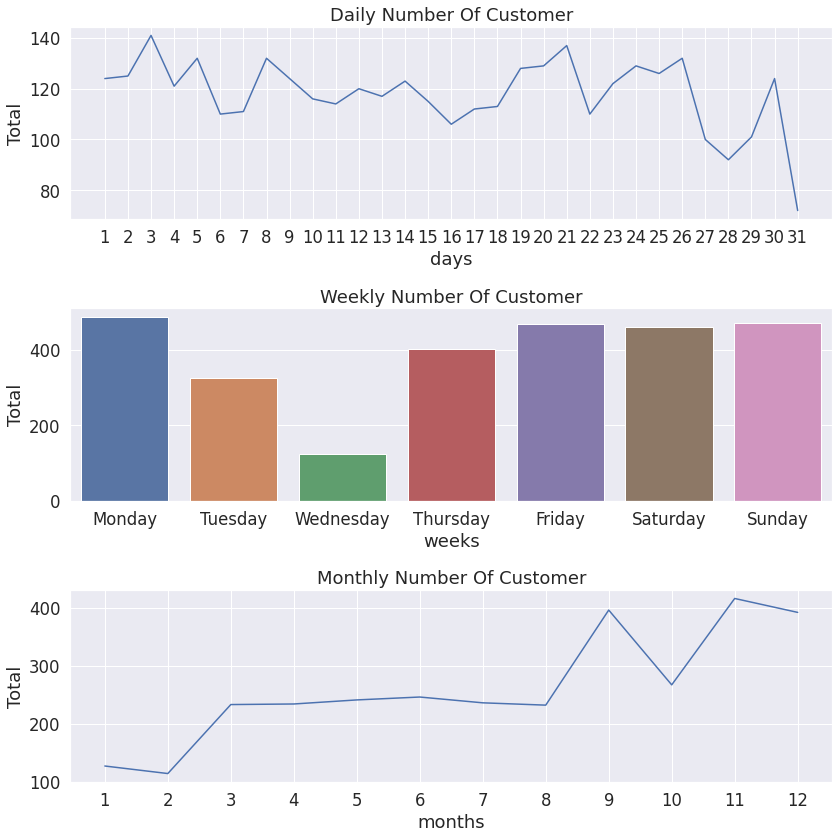

In [14]:
customer_daily = df.groupby("days",as_index=False).agg({"Customer ID":lambda x: x.nunique()})

order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
customer_weeks = df.groupby("weeks",as_index=False).agg({"Customer ID":lambda x: x.nunique()})
customer_months = df.groupby("months",as_index=False).agg({"Customer ID":lambda x: x.nunique()})

plt.figure(figsize=(12,12))
plt.subplot(311)
sns.lineplot(data=customer_daily,x="days",y="Customer ID").set_title("Daily Number Of Customer")
plt.xticks([i for i in np.arange(1,32)])
plt.ylabel("Total")

plt.subplot(312)
sns.barplot(data=customer_weeks,x="weeks",y="Customer ID",order=order).set_title("Weekly Number Of Customer")
plt.ylabel("Total")

plt.subplot(313)
sns.lineplot(data=customer_months,x="months",y="Customer ID").set_title("Monthly Number Of Customer")
plt.xticks([i for i in np.arange(1,13)])
plt.ylabel("Total")

plt.tight_layout()
plt.show()

1.Total Pengunjung datang memiliki trend menurun hingga 2 minggu kedepan, selanjutnya mengalami peningkatan hingga ditanggal 21 dan selanjutnya mengalami penurunan kembali.

2.Senin Jumat Sabtu dan Minggu memiliki jumlah pengunjung yg relatif banyak.

3.Peningkatan Trend Pengunjung berada dibulan 8 sampai dengan akhir tahun

Total Transaction

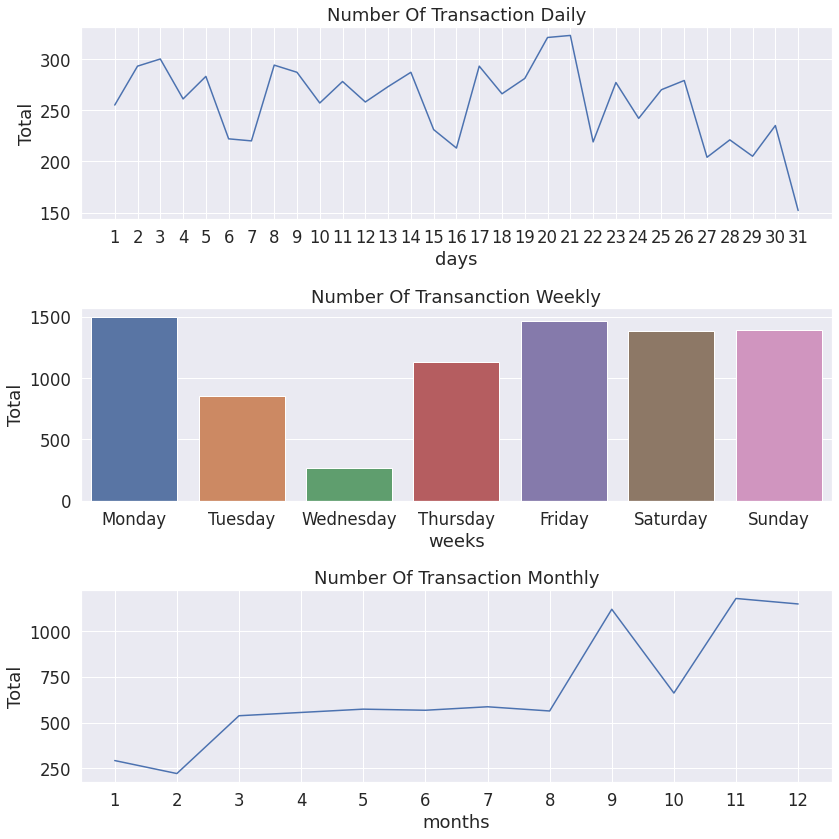

In [17]:
trx_daily = df.groupby("days",as_index=False)["Order ID"].size()

order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
trx_weekly = df.groupby("weeks",as_index=False)["Order ID"].size()

trx_monthly = df.groupby("months",as_index=False)["Order ID"].size()

plt.figure(figsize=(12,12))
plt.subplot(311)
sns.lineplot(data=trx_daily,x="days",y="size").set_title("Number Of Transaction Daily")
plt.xticks([i for i in np.arange(1,32)])
plt.ylabel("Total")

plt.subplot(312)
sns.barplot(data=trx_weekly,x="weeks",y="size",order=order).set_title("Number Of Transanction Weekly")
plt.ylabel("Total")

plt.subplot(313)
sns.lineplot(data=trx_monthly,x="months",y="size").set_title("Number Of Transaction Monthly")
plt.xticks([i for i in np.arange(1,13)])
plt.ylabel("Total")

plt.tight_layout()
plt.show()

1.Total Transaksi harian pada tangal 1-3 jumlah pengunjung banyak, kemudian berkurang pada tanggal 3 hingga 7, dan meningkat kembali di tanggal 8 dan konsisten hingga tanggal 14 dan mengalami penurunan kembali pada tanggal 15 dan 16 kemudian meningkat kembali di 17 hingga 21 dan mengalami tren turun hingga akhir bulan.

2.Total Transaksi yang banyak pada hari senin,jumat,sabtu dan minggu. hal ini dikarenakan selaras dengan Total pengunjung dimana pada hari tersebut memiliki jumlah pengunjung yg cukup banyak.

3.Terdapat kenaikan trend pada bulan 8 sampai dengan akhir tahun.

GMV

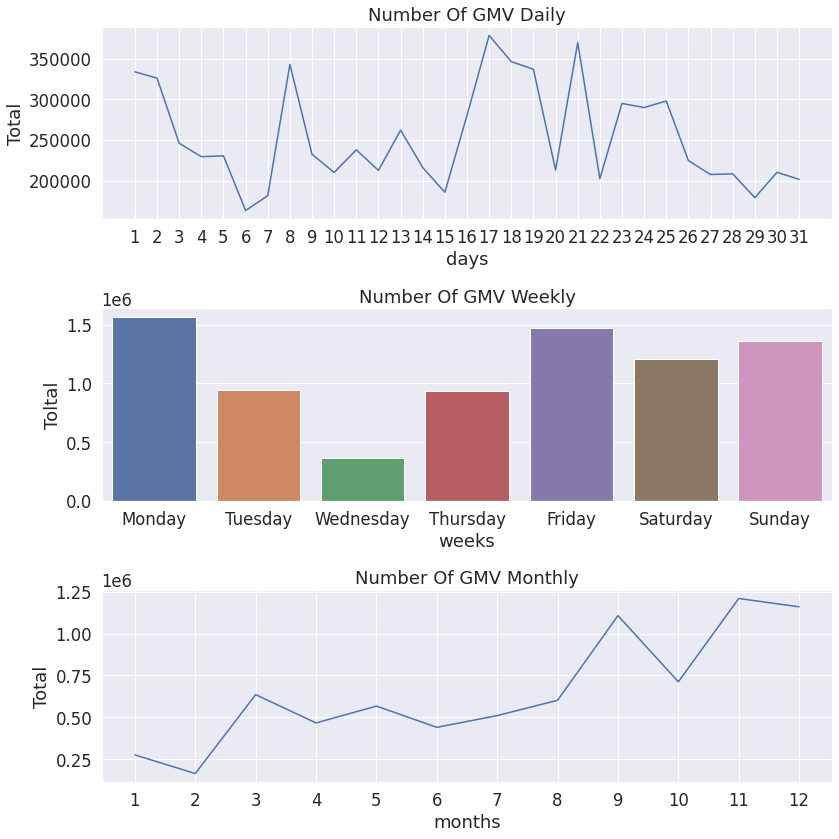

In [21]:
gmv_daily = df.groupby("days",as_index=False)["GMV"].sum()

order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
gmv_weekly = df.groupby("weeks",as_index=False)["GMV"].sum()

gmv_monthly = df.groupby("months",as_index=False)["GMV"].sum()

plt.figure(figsize=(12,12))
plt.subplot(311)
sns.lineplot(data=gmv_daily,x="days",y="GMV").set_title("Number Of GMV Daily")
plt.xticks([i for i in np.arange(1,32)])
plt.ylabel("Total")

plt.subplot(312)
sns.barplot(data=gmv_weekly,x="weeks",y="GMV",order=order).set_title("Number Of GMV Weekly")
plt.ylabel("Toltal")

plt.subplot(313)
sns.lineplot(data=gmv_monthly,x="months",y="GMV").set_title("Number Of GMV Monthly")
plt.xticks([i for i in np.arange(1,13)])
plt.ylabel("Total")

plt.tight_layout()
plt.show()

1.Pada Nilai Jumlah GMV harian terlihat adanya trend menurun di tanggal 1 hingga 6, kemudian mengalami kenaikan di tanggal 7 dan stabil sampai dengan  tanggal 21 dan mengalami penurunan yg signifikan setelah tanggal 21 sampai dengan akhir bulan.

2.Total GMV yang besar terjadi pada hari senin,jumat,sabtu dan minggu.

3.Terjadinya peningkatan trend dari bulan 8 sampai dengan akhir tahun pada GMV Monthly

Total Profit

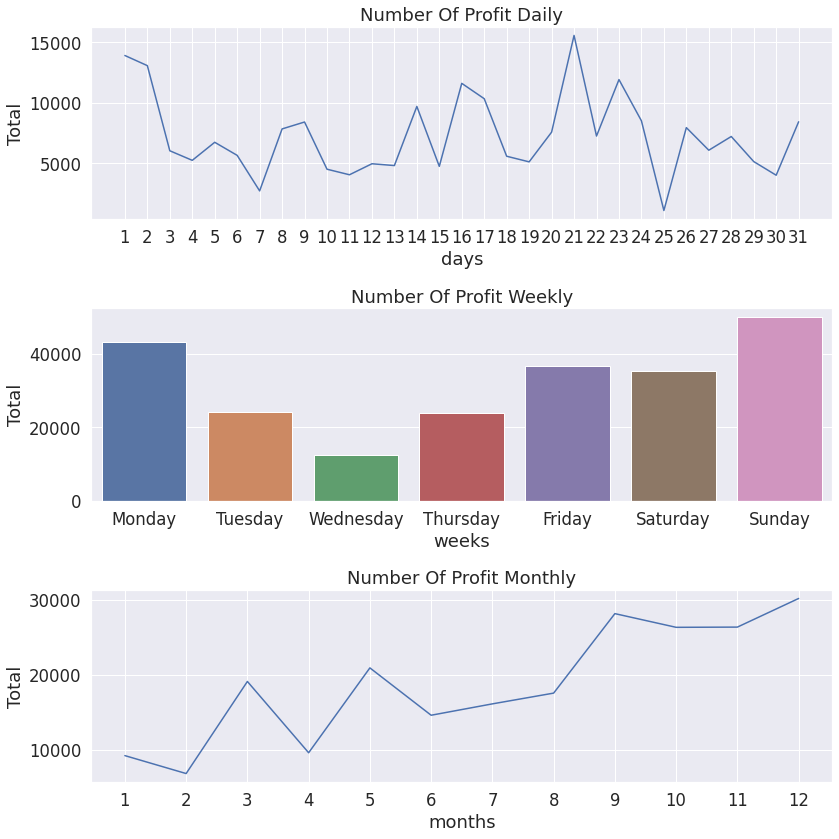

In [27]:
profit_daily = df.groupby("days",as_index=False)["Profit"].sum()

order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
profit_weekly = df.groupby("weeks",as_index=False)["Profit"].sum()

profit_monthly = df.groupby("months",as_index=False)["Profit"].sum()

plt.figure(figsize=(12,12))
plt.subplot(311)
sns.lineplot(data=profit_daily,x="days",y="Profit").set_title("Number Of Profit Daily")
plt.xticks([i for i in np.arange(1,32)])
plt.ylabel("Total")

plt.subplot(312)
sns.barplot(data=profit_weekly,x="weeks",y="Profit",order=order).set_title("Number Of Profit Weekly")
plt.ylabel("Total")

plt.subplot(313)
sns.lineplot(data=profit_monthly,x="months",y="Profit").set_title("Number Of Profit Monthly")
plt.xticks([i for i in np.arange(1,13)])
plt.ylabel("Total")

plt.tight_layout()
plt.show()

1.Pada Total Profit Harian mengalami penurunan di 7 hari pertama pada awal bulan dan mengalami peningkatan dari tanggal 8 hingga tanggal 21 dan setelahnya terjadi penurunan sampai dengan akhir bulan

2.Profit yg cukup besar terjadi pada hari Senin dan Minggu.

3.Pola trend profit meningkat di bulan 9-12. hal ini terjadi dikarenakan terdapat kesamaan pola antara jumlah transaksi,GMV dan profit, jadi dengan besarnya jumlah transaksi yang terjadi makan GMV dan profit akan semakin besar

Advance Nomor 2

Hitunglah monthly retention dari kegiatan transaksi yang terjadi di dalam platform e-commerce. (Poin 10) Catatan: Monthly retention dihitung berdasarkan jumlah customer yang kembali 

In [ ]:
df_ret = df.copy()

import datetime as dt
def get_month(x): return dt.datetime(x.year, x.month, 1) 

df_ret['TransactionMonth'] = df_ret['Order Date'].apply(get_month) 

grouping = df_ret.groupby('Customer ID')['TransactionMonth'] 

df_ret['CohortMonth'] = grouping.transform('min')

df_ret

In [29]:
def get_date_int(df, column):
    year = df[column].dt.year
    month = df[column].dt.month
    day = df[column].dt.day
    return year, month, day

transcation_year, transaction_month, _ = get_date_int(df_ret, 'TransactionMonth')

cohort_year, cohort_month, _ = get_date_int(df_ret, 'CohortMonth')

years_diff = transcation_year - cohort_year

months_diff = transaction_month - cohort_month

df_ret['CohortIndex'] = years_diff * 12 + months_diff  + 1 

df_ret

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,State,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,GMV,months,days,weeks,TransactionMonth,CohortMonth,CohortIndex
0,1,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,2,0.00,41.9136,523.920000,11,8,Tuesday,2016-11-01,2015-10-01,14
1,2,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,Kentucky,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,3,0.00,219.5820,2195.820000,11,8,Tuesday,2016-11-01,2015-10-01,14
2,3,CA-2016-138688,2016-06-12,2016-06-16,Second Class,DV-13045,Darrin Van Huff,Corporate,United States,Los Angeles,California,90036,West,OFF-LA-10000240,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,2,0.00,6.8714,29.240000,6,12,Sunday,2016-06-01,2016-06-01,1
3,4,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.0310,2633.338125,10,11,Sunday,2015-10-01,2015-10-01,1
4,5,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,Florida,33311,South,OFF-ST-10000760,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2,0.20,2.5164,35.788800,10,11,Sunday,2015-10-01,2015-10-01,1
5,6,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,FUR-FU-10001487,Furniture,Furnishings,Eldon Expressions Wood and Plastic Desk Access...,48.8600,7,0.00,14.1694,342.020000,6,9,Monday,2014-06-01,2014-06-01,1
6,7,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AR-10002833,Office Supplies,Art,Newell 322,7.2800,4,0.00,1.9656,29.120000,6,9,Monday,2014-06-01,2014-06-01,1
7,8,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,TEC-PH-10002275,Technology,Phones,Mitel 5320 IP Phone VoIP phone,907.1520,6,0.20,90.7152,4354.329600,6,9,Monday,2014-06-01,2014-06-01,1
8,9,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-BI-10003910,Office Supplies,Binders,DXL Angle-View Binders with Locking Rings by S...,18.5040,3,0.20,5.7825,44.409600,6,9,Monday,2014-06-01,2014-06-01,1
9,10,CA-2014-115812,2014-06-09,2014-06-14,Standard Class,BH-11710,Brosina Hoffman,Consumer,United States,Los Angeles,California,90032,West,OFF-AP-10002892,Office Supplies,Appliances,Belkin F5C206VTEL 6 Outlet Surge,114.9000,5,0.00,34.4700,574.500000,6,9,Monday,2014-06-01,2014-06-01,1


In [32]:
grouping = df_ret.groupby(['CohortMonth', 'CohortIndex'])

cohort_data = grouping['Customer ID'].apply(pd.Series.nunique)
cohort_data = cohort_data.reset_index()
cohort_counts = cohort_data.pivot(index='CohortMonth',columns ='CohortIndex',values = 'Customer ID')

cohort_data.head()

,CohortMonth,CohortIndex,Customer ID
0,2014-01-01,1,27
1,2014-01-01,4,2
2,2014-01-01,5,2
3,2014-01-01,7,2
4,2014-01-01,8,1


In [33]:
cohort_sizes = cohort_counts.iloc[:,0]

retention = cohort_counts.divide(cohort_sizes, axis=0)
retention.round(3)*100

CohortIndex,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48
CohortMonth,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2014-01-01,100.0,NaN,NaN,7.4,7.4,NaN,7.4,3.7,3.7,11.1,18.5,11.1,7.4,NaN,11.1,7.4,3.7,11.1,7.4,7.4,11.1,NaN,18.5,14.8,7.4,3.7,14.8,7.4,11.1,11.1,3.7,NaN,25.9,3.7,18.5,14.8,11.1,3.7,14.8,11.1,18.5,11.1,3.7,3.7,22.2,33.3,22.2,14.8
2014-02-01,100.0,5.9,5.9,NaN,NaN,11.8,5.9,17.6,5.9,5.9,23.5,NaN,NaN,5.9,5.9,5.9,11.8,5.9,NaN,23.5,NaN,11.8,11.8,NaN,5.9,5.9,5.9,11.8,NaN,11.8,17.6,17.6,5.9,5.9,17.6,11.8,5.9,23.5,11.8,5.9,23.5,NaN,5.9,23.5,5.9,29.4,NaN,NaN
2014-03-01,100.0,5.9,2.0,13.7,9.8,NaN,9.8,3.9,7.8,7.8,2.0,2.0,7.8,3.9,7.8,2.0,2.0,5.9,3.9,13.7,19.6,15.7,2.0,2.0,7.8,11.8,11.8,11.8,7.8,7.8,13.7,7.8,13.7,5.9,3.9,3.9,9.8,13.7,11.8,13.7,9.8,11.8,25.5,3.9,21.6,17.6,NaN,NaN
2014-04-01,100.0,6.8,NaN,6.8,4.5,6.8,6.8,13.6,11.4,2.3,2.3,6.8,18.2,13.6,4.5,4.5,6.8,11.4,4.5,20.5,13.6,4.5,2.3,9.1,9.1,6.8,15.9,13.6,4.5,20.5,9.1,15.9,15.9,6.8,4.5,18.2,4.5,11.4,11.4,11.4,13.6,15.9,13.6,13.6,20.5,NaN,NaN,NaN
2014-05-01,100.0,10.2,6.1,4.1,16.3,6.1,16.3,16.3,6.1,4.1,4.1,12.2,2.0,8.2,4.1,6.1,10.2,8.2,16.3,12.2,8.2,4.1,4.1,14.3,12.2,8.2,4.1,4.1,16.3,6.1,20.4,20.4,4.1,4.1,4.1,6.1,12.2,12.2,10.2,8.2,30.6,16.3,22.4,16.3,NaN,NaN,NaN,NaN
2014-06-01,100.0,4.9,NaN,7.3,4.9,14.6,9.8,2.4,9.8,12.2,7.3,9.8,7.3,12.2,4.9,4.9,9.8,31.7,12.2,7.3,2.4,12.2,9.8,9.8,2.4,7.3,2.4,19.5,12.2,12.2,26.8,7.3,7.3,4.9,14.6,9.8,14.6,9.8,4.9,22.0,7.3,29.3,22.0,NaN,NaN,NaN,NaN,NaN
2014-07-01,100.0,8.8,11.8,NaN,14.7,20.6,8.8,2.9,17.6,2.9,8.8,8.8,8.8,NaN,14.7,5.9,11.8,14.7,2.9,2.9,5.9,2.9,11.8,5.9,8.8,23.5,11.8,14.7,20.6,20.6,5.9,14.7,8.8,5.9,14.7,11.8,8.8,11.8,17.6,8.8,23.5,17.6,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-01,100.0,11.1,4.4,13.3,6.7,4.4,6.7,4.4,8.9,2.2,8.9,17.8,4.4,13.3,4.4,4.4,20.0,4.4,2.2,4.4,6.7,8.9,15.6,8.9,15.6,26.7,8.9,24.4,17.8,4.4,8.9,2.2,15.6,8.9,11.1,15.6,13.3,17.8,26.7,17.8,17.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-09-01,100.0,6.2,10.8,12.3,1.5,4.6,7.7,10.8,9.2,1.5,6.2,6.2,15.4,6.2,10.8,16.9,3.1,1.5,13.8,7.7,9.2,7.7,9.2,4.6,9.2,4.6,13.8,18.5,1.5,3.1,9.2,10.8,9.2,12.3,12.3,12.3,18.5,10.8,16.9,16.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
cohort_sizes = cohort_counts.iloc[:,0]

retention = cohort_counts.divide(cohort_sizes, axis=0)
retention.round(3)*100

CohortIndex,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48
CohortMonth,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2014-01-01,100.0,NaN,NaN,7.4,7.4,NaN,7.4,3.7,3.7,11.1,18.5,11.1,7.4,NaN,11.1,7.4,3.7,11.1,7.4,7.4,11.1,NaN,18.5,14.8,7.4,3.7,14.8,7.4,11.1,11.1,3.7,NaN,25.9,3.7,18.5,14.8,11.1,3.7,14.8,11.1,18.5,11.1,3.7,3.7,22.2,33.3,22.2,14.8
2014-02-01,100.0,5.9,5.9,NaN,NaN,11.8,5.9,17.6,5.9,5.9,23.5,NaN,NaN,5.9,5.9,5.9,11.8,5.9,NaN,23.5,NaN,11.8,11.8,NaN,5.9,5.9,5.9,11.8,NaN,11.8,17.6,17.6,5.9,5.9,17.6,11.8,5.9,23.5,11.8,5.9,23.5,NaN,5.9,23.5,5.9,29.4,NaN,NaN
2014-03-01,100.0,5.9,2.0,13.7,9.8,NaN,9.8,3.9,7.8,7.8,2.0,2.0,7.8,3.9,7.8,2.0,2.0,5.9,3.9,13.7,19.6,15.7,2.0,2.0,7.8,11.8,11.8,11.8,7.8,7.8,13.7,7.8,13.7,5.9,3.9,3.9,9.8,13.7,11.8,13.7,9.8,11.8,25.5,3.9,21.6,17.6,NaN,NaN
2014-04-01,100.0,6.8,NaN,6.8,4.5,6.8,6.8,13.6,11.4,2.3,2.3,6.8,18.2,13.6,4.5,4.5,6.8,11.4,4.5,20.5,13.6,4.5,2.3,9.1,9.1,6.8,15.9,13.6,4.5,20.5,9.1,15.9,15.9,6.8,4.5,18.2,4.5,11.4,11.4,11.4,13.6,15.9,13.6,13.6,20.5,NaN,NaN,NaN
2014-05-01,100.0,10.2,6.1,4.1,16.3,6.1,16.3,16.3,6.1,4.1,4.1,12.2,2.0,8.2,4.1,6.1,10.2,8.2,16.3,12.2,8.2,4.1,4.1,14.3,12.2,8.2,4.1,4.1,16.3,6.1,20.4,20.4,4.1,4.1,4.1,6.1,12.2,12.2,10.2,8.2,30.6,16.3,22.4,16.3,NaN,NaN,NaN,NaN
2014-06-01,100.0,4.9,NaN,7.3,4.9,14.6,9.8,2.4,9.8,12.2,7.3,9.8,7.3,12.2,4.9,4.9,9.8,31.7,12.2,7.3,2.4,12.2,9.8,9.8,2.4,7.3,2.4,19.5,12.2,12.2,26.8,7.3,7.3,4.9,14.6,9.8,14.6,9.8,4.9,22.0,7.3,29.3,22.0,NaN,NaN,NaN,NaN,NaN
2014-07-01,100.0,8.8,11.8,NaN,14.7,20.6,8.8,2.9,17.6,2.9,8.8,8.8,8.8,NaN,14.7,5.9,11.8,14.7,2.9,2.9,5.9,2.9,11.8,5.9,8.8,23.5,11.8,14.7,20.6,20.6,5.9,14.7,8.8,5.9,14.7,11.8,8.8,11.8,17.6,8.8,23.5,17.6,NaN,NaN,NaN,NaN,NaN,NaN
2014-08-01,100.0,11.1,4.4,13.3,6.7,4.4,6.7,4.4,8.9,2.2,8.9,17.8,4.4,13.3,4.4,4.4,20.0,4.4,2.2,4.4,6.7,8.9,15.6,8.9,15.6,26.7,8.9,24.4,17.8,4.4,8.9,2.2,15.6,8.9,11.1,15.6,13.3,17.8,26.7,17.8,17.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-09-01,100.0,6.2,10.8,12.3,1.5,4.6,7.7,10.8,9.2,1.5,6.2,6.2,15.4,6.2,10.8,16.9,3.1,1.5,13.8,7.7,9.2,7.7,9.2,4.6,9.2,4.6,13.8,18.5,1.5,3.1,9.2,10.8,9.2,12.3,12.3,12.3,18.5,10.8,16.9,16.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
retention.index = retention.index.strftime('%Y-%m')
retention.index

Index(['2014-01', '2014-02', '2014-03', '2014-04', '2014-05', '2014-06',
       '2014-07', '2014-08', '2014-09', '2014-10', '2014-11', '2014-12',
       '2015-01', '2015-02', '2015-03', '2015-04', '2015-05', '2015-06',
       '2015-07', '2015-08', '2015-09', '2015-10', '2015-11', '2015-12',
       '2016-01', '2016-02', '2016-03', '2016-04', '2016-05', '2016-06',
       '2016-07', '2016-08', '2016-09', '2016-10', '2016-11', '2016-12',
       '2017-01', '2017-03', '2017-04', '2017-05', '2017-06', '2017-07',
       '2017-09', '2017-10', '2017-11'],
      dtype='object', name='CohortMonth')

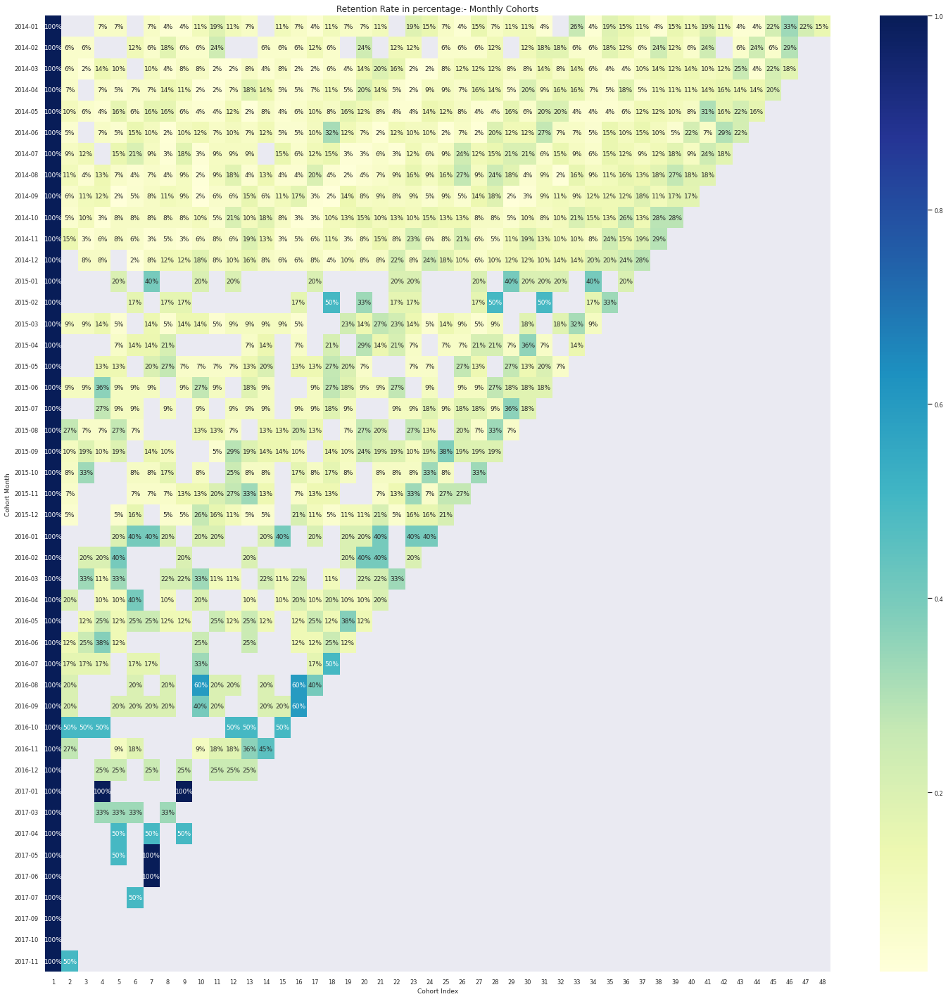

In [36]:
plt.figure(figsize=(25,25))
sns.set(font_scale=0.75)

plt.title('Retention Rate in percentage:- Monthly Cohorts', fontsize = 12)

sns.heatmap(retention, annot=True, fmt= '.0%',cmap='YlGnBu')
plt.ylabel('Cohort Month')
plt.xlabel('Cohort Index')
plt.yticks( rotation='360')
plt.show()

Bedasarkan retention rate dapat terlihat bahwa dalam jangka waktu 2-3 bulan setelah pengunjung datang dan melakukan pembelian terdapat kemungkinan pengunjung tersebut akan kembali datang dan melakukan pembelian kembali, hal ini bisa menjadi strategi untuk memberikan gambaran informasi yg dapat digunakan untuk melakukan pengambilan strategi bisnis terkait, baik untuk memberikan rekomendasi produk, diskon menarik, ataupun daftar produk baru yg dapat menarik minat pengunjung untuk melakukan pembelian kembali.

Nomor 3

Identifikasi produk-produk apa saja yang membawa profit terbesar dalam 3 bulan terakhir (Poin 5)


In [37]:
product_3m = df[(df['Order Date']>='2017-10-01 00:00:00')&(df['Order Date']<='2017-12-30 00:00:00')].copy()
df.groupby("Product Name")["Profit"].sum().nlargest()

Product Name
Canon imageCLASS 2200 Advanced Copier                         18479.9472
Hewlett Packard LaserJet 3310 Copier                           6743.8876
Ativa V4110MDD Micro-Cut Shredder                              3772.9461
3D Systems Cube Printer, 2nd Generation, Magenta               3717.9714
Plantronics Savi W720 Multi-Device Wireless Headset System     3696.2820
Name: Profit, dtype: float64

"Canon imageCLASS 2200 Advanced Copier" dengan harga 18479.9472 menjadi produk dengan profit terbesar dalam 3 bulan terakhir

Nomor 4

Forecasting Jumlah Pengunjung Harian

<AxesSubplot:>

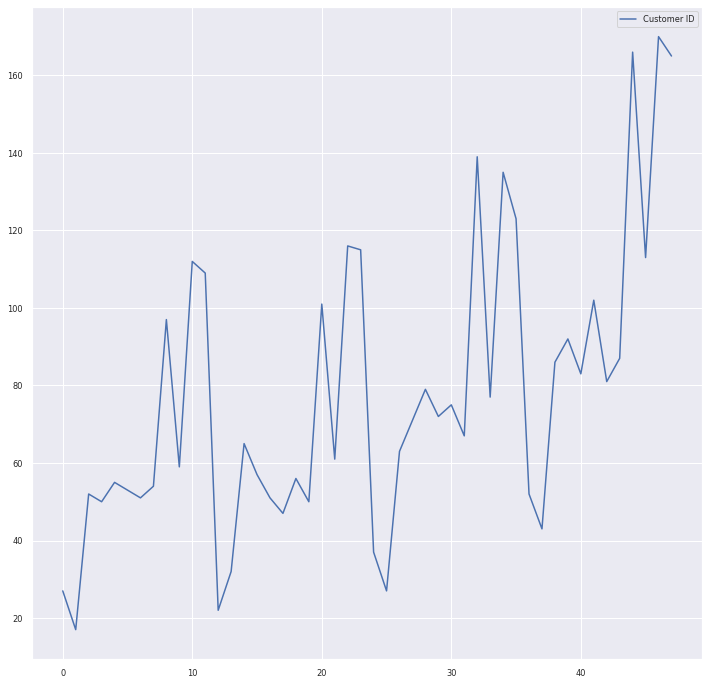

In [38]:
df["monht_year"] = df['Order Date'].dt.to_period('M')
df.groupby(["monht_year"],as_index=False).agg({'Customer ID':lambda x: x.nunique()}).plot(figsize=(12,12))

Jumlah pengunjung mengalami peningkatan dibulan 9-10. Jika dilakukan dengan pendekatan harian, seasonal period berkisar 250-270 hari.

In [39]:
df_customer = df.groupby(["Order Date"],as_index=False).agg({'Customer ID':lambda x: x.nunique()})
df_customer = df_customer[(df_customer["Order Date"]>="2016-01-01 00:00:00")]
df_customer.shape

(617, 2)

In [42]:
forecast = df_customer.set_index("Order Date")
forecast.columns = ["Number Of Visitor"]
forecast.index = pd.PeriodIndex(forecast.index, freq = 'D')
forecast.head()

,Number Of Visitor
Order Date,
2016-01-02,1
2016-01-03,1
2016-01-04,2
2016-01-05,1
2016-01-07,1


(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:ylabel='Number Of Visitor'>)

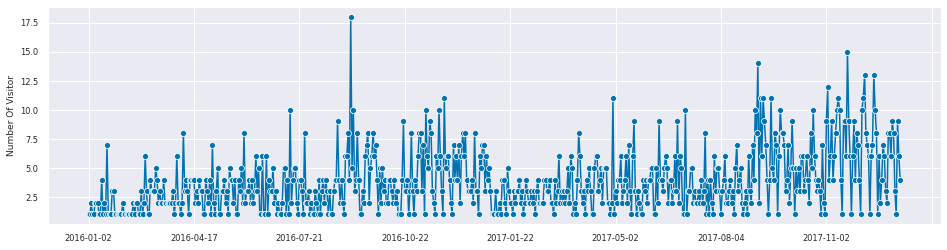

In [43]:
plot_series(forecast["Number Of Visitor"])

<AxesSubplot:>

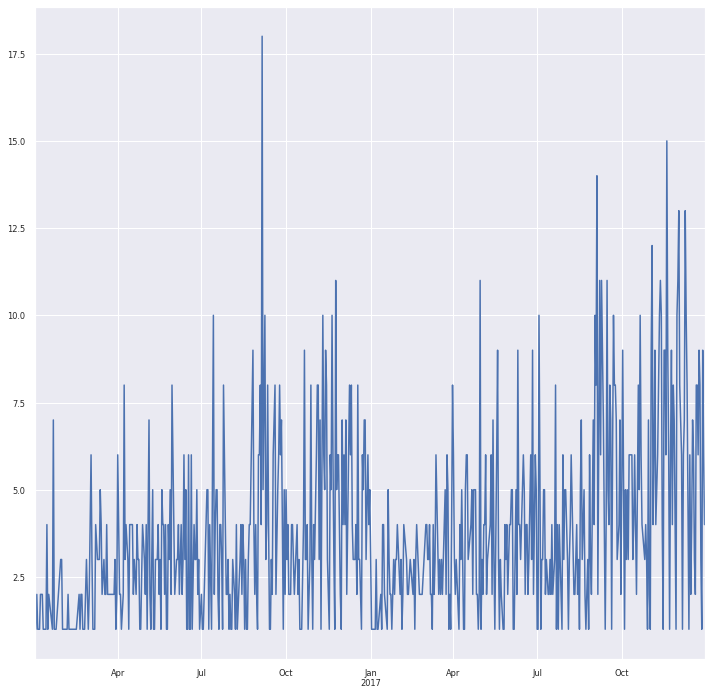

In [44]:
forecast["Number Of Visitor"].plot(figsize=(12,12))

In [45]:
def test_stationarity(ts,window=10,**kwargs):
    plot_df = pd.DataFrame(ts)
    plot_df["rolling_mean"] = ts.rolling(window).mean()
    plot_df['rolling_std'] = ts.rolling(window).std()
    p_val = adfuller(ts)[1]
    ax = plot_df.plot(**kwargs)
    ax.set_title(f"Dicky-Fuller p-value :{p_val:.3f}")

Number Of Visitor    None
dtype: object

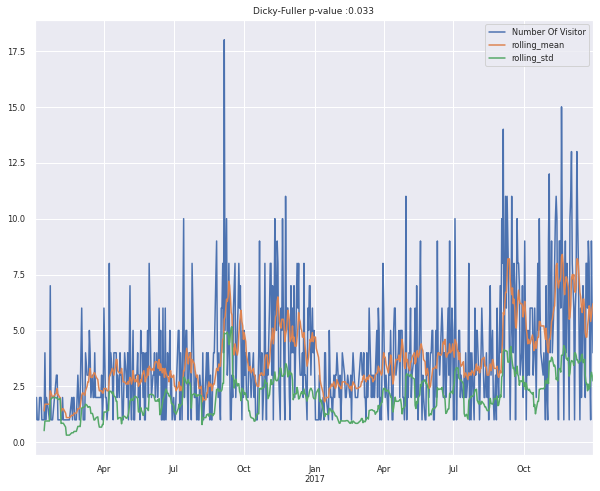

In [46]:
forecast.apply(test_stationarity,figsize=(10, 8))

(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:ylabel='Number Of Visitor'>)

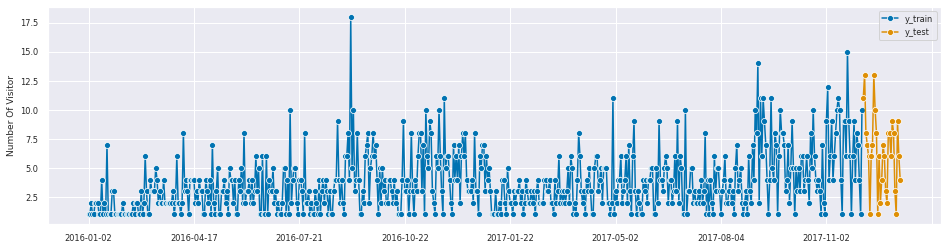

In [47]:
y_train, y_test = temporal_train_test_split(forecast["Number Of Visitor"], test_size=29)
plot_series(y_train, y_test, labels=["y_train", "y_test"])

In [48]:
fh = ForecastingHorizon(y_test.index, is_relative=False)

ets_forecaster = ExponentialSmoothing(trend=None, seasonal='multiplicative', sp=250)

ets_forecaster.fit(y_train)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/holtwinters/model.py:917: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning,


ExponentialSmoothing(seasonal='multiplicative', sp=250)

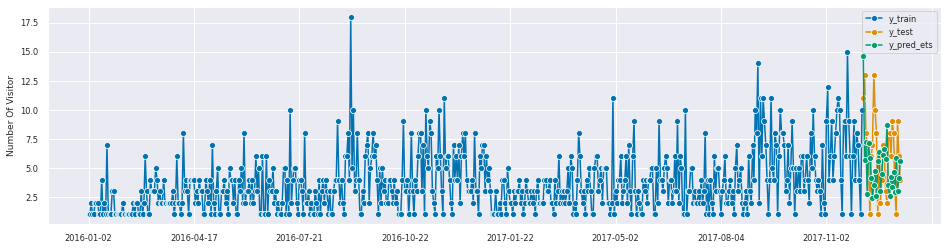

In [49]:
y_pred_ets = ets_forecaster.predict(fh=fh)
plot_series(y_train, y_test, y_pred_ets, labels=["y_train", "y_test", "y_pred_ets"]);

In [50]:
mean_absolute_percentage_error(y_test, y_pred_ets) * 100

97.09652995015767

In [51]:
auto_ets_forecaster = AutoETS(auto=True, sp=250)
auto_ets_forecaster.fit(y_train)

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: 

AutoETS(auto=True, sp=250)

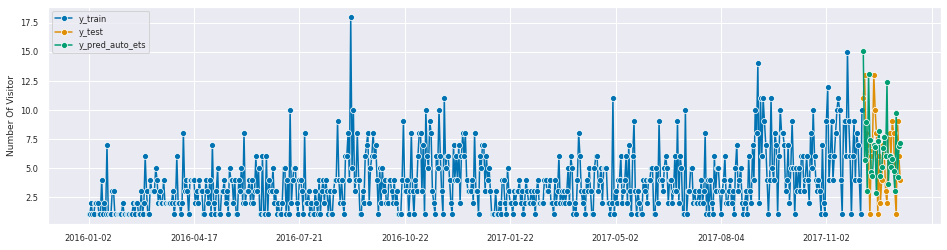

In [52]:
y_pred_auto_ets = auto_ets_forecaster.predict(fh=fh)
plot_series(y_train, y_test, y_pred_auto_ets, labels=["y_train", "y_test", "y_pred_auto_ets"]);

In [53]:
mean_absolute_percentage_error(y_test, y_pred_auto_ets) * 100

130.31968900942155

nilai MAPE terkecil adalah model ets sebesar 97.09652995015767

Forecasting Jumlah Transaksi

<AxesSubplot:>

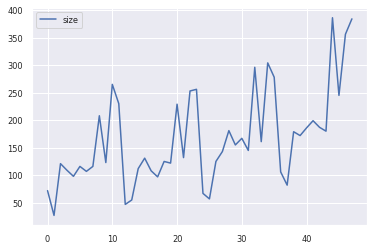

In [54]:
df.groupby(["monht_year"],as_index=False)["Order ID"].size().plot()

Dapat terlihat seasonal dari jumlah transaksi sama dengan seasonal jumlah pengunjung, sehingga dapat dikatakan bahwa terjadi korelasi yg positif antara jumlah pengunjung dengan jumlah transaksi, dengan pendekatan yang sama pendekatan seasonal harian berkisar 250-270

In [55]:
df_trans = df.groupby(["Order Date"],as_index=False)['Order ID'].size()
df_trans = df_trans[(df_trans["Order Date"]>="2016-01-01 00:00:00")]
df_trans.shape

(617, 2)

In [58]:
trans_forecast = df_trans.set_index("Order Date")
trans_forecast.columns = ["Total Transaction"]
trans_forecast.index = pd.PeriodIndex(trans_forecast.index, freq = 'D')
trans_forecast.head()

,Total Transaction
Order Date,
2016-01-02,2
2016-01-03,1
2016-01-04,3
2016-01-05,3
2016-01-07,1


(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:ylabel='Total Transaction'>)

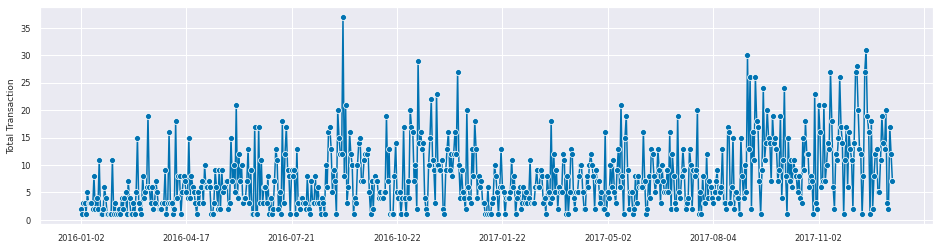

In [59]:
plot_series(trans_forecast["Total Transaction"])

Total Transaction    None
dtype: object

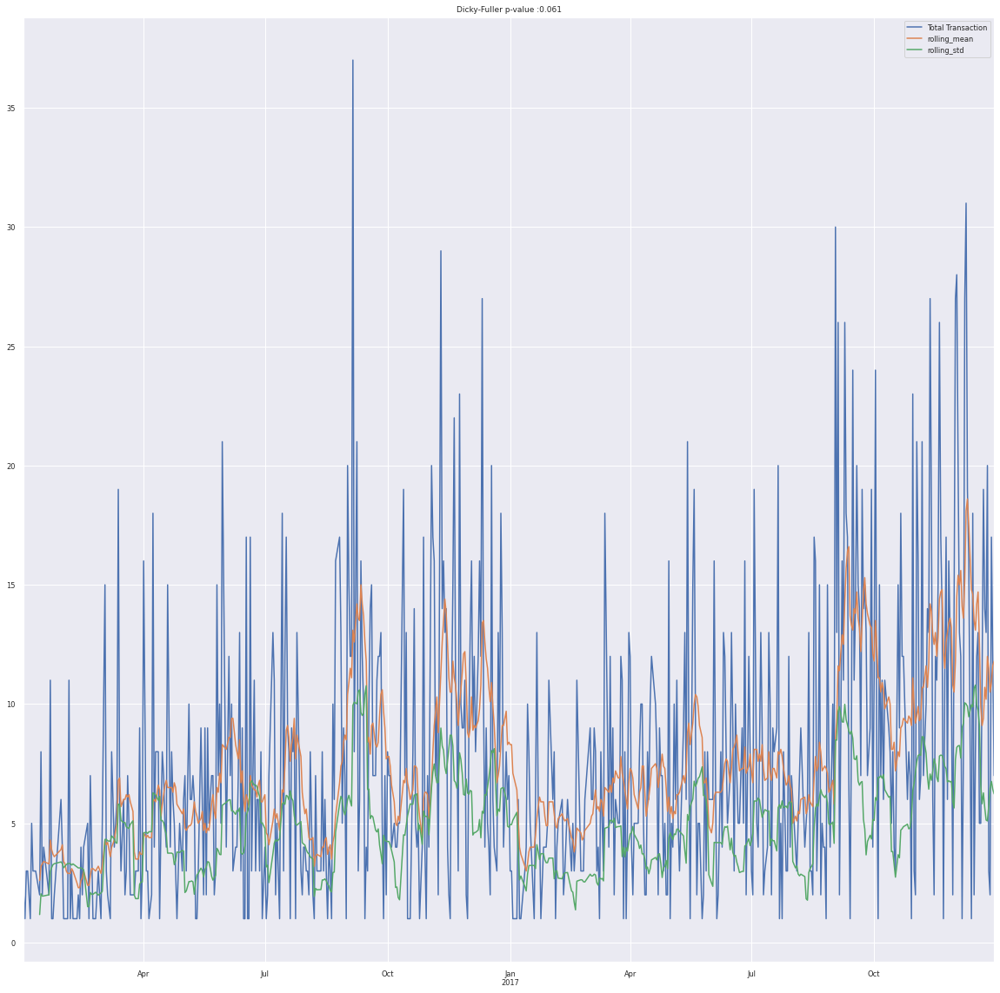

In [60]:
trans_forecast.apply(test_stationarity,figsize=(20,20))

(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:ylabel='Total Transaction'>)

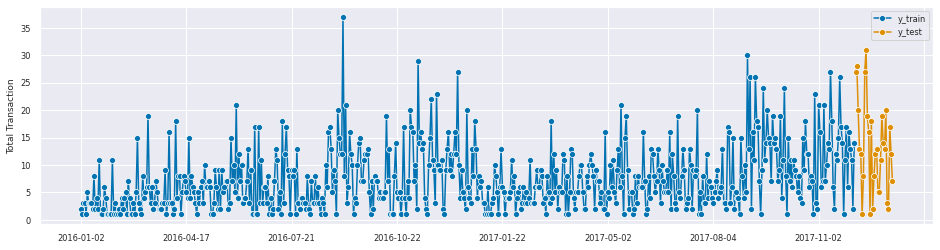

In [63]:
y_train, y_test = temporal_train_test_split(trans_forecast["Total Transaction"], test_size=29)

plot_series(y_train, y_test, labels=["y_train", "y_test"])

In [64]:
fh = ForecastingHorizon(y_test.index, is_relative=False)

In [65]:
ets_forecaster = ExponentialSmoothing(trend=None, seasonal='multiplicative', sp=250)

In [66]:
ets_forecaster.fit(y_train)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/holtwinters/model.py:917: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning,


ExponentialSmoothing(seasonal='multiplicative', sp=250)

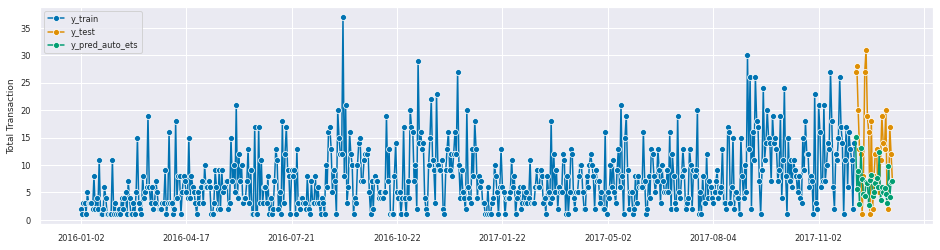

In [67]:
y_pred_ets = ets_forecaster.predict(fh=fh)
plot_series(y_train, y_test, y_pred_auto_ets, labels=["y_train", "y_test", "y_pred_auto_ets"]);

In [68]:
mean_absolute_percentage_error(y_test, y_pred_ets) * 100

201.4783482770654

In [69]:
auto_ets_forecaster = AutoETS(auto=True, sp=250)

auto_ets_forecaster.fit(y_train)

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning: 

AutoETS(auto=True, sp=250)

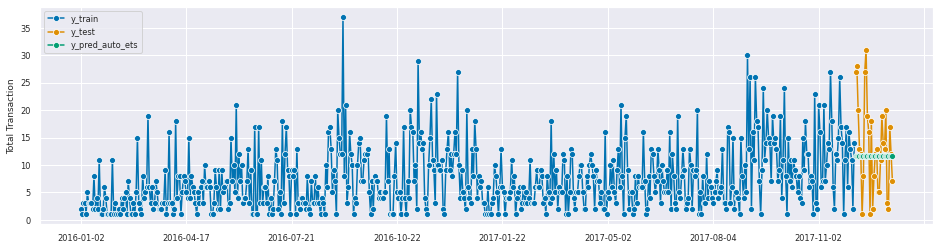

In [70]:
y_pred_auto_ets = auto_ets_forecaster.predict(fh=fh)

plot_series(y_train, y_test, y_pred_auto_ets, labels=["y_train", "y_test", "y_pred_auto_ets"]);

In [71]:
mean_absolute_percentage_error(y_test, y_pred_auto_ets) * 100

149.51856443379285

dari hasil model time series, model auto ets memiliki mape terkecil sehingga model auto ets lebih baik dari model ets

Recomendation

1. Dari segi "Monthly" dapat dilakukan strategy diskon dan promo khusus pada bulan 1 sampai bulan 8 dengan tujuan meningkatkan volume jumlah pengunjung dan menarik pengunjung baru, serta dapat juga diberikan promo membership dan loyalty program untuk pengunjung lama.
Untuk bulan ke 8 sampai dengan akhir bulan dapat diberikan strategy "Hard Sale" seperti "promo buy 1 get 1" untuk produk yg kurang laku / stock lama dan diskon khusus untuk produk "new arrival" serta add on seperti "buy (produk populer) get (aksesoris / item lainnya) untuk produk yg populer di pengunjung dengan tujuan untuk meningkatkan volume penjualan secara signifikan dikarenakan bedasarkan data dapat dilihat pada bulan tersebut jumlah pengunjung cukup banyak sehingga dapat di maksimalkan penjualannya. 

2. Dari segi harian dapat dilakukan strategi pemberian diskon dan promo khusus pada hari selasa - sabtu, dengan tujuan untuk meningkatkan volume pengunjung yg diharapkan dapat meningkatkan penjualan dan nilai tranksaksi didalamnya.
Sedangkan pada hari Minggu dan Senin dapat diberikan penawaran khusus, promo, dan diskon spesial yg bertujuan peningkatan jumlah tranksaksi, dikarenakan pada hari Minggu dan Senin terdapat jumlah pengunjung yg cukup banyak jika dilihat dari data. 
Perbedaan pemberian promo, diskon, dan penawaran dalam harian adalah dari target tujuan promo, diskon, dan penawaran nya, jika pada Senin dan Minggu diberikan promo, diskon, dan penawaran dengan tujuan "Hard Sale" atau pembelian tranksaksi, sedangkan pada Selasa - Sabtu pemberian promo, diskon, dan penawaran bertujuan untuk peningkatan volume yg bertujuan meningkatkan tranksaksi di hari tersebut.

3. Pada bulan ke 8 sampai akhir tahun agar dapat dimaksimalkan pemberian promo, diskon, dan penawaran yg diberikan, hal ini bertujuan selain untuk memaksimalkan nilai Profit dan jumlah transaksi juga bertujuan untuk menghabiskan stok produk untuk barang yg kurang laku dipasaran, serta untuk stock barang yg populer agar diperbanyak stocknya pada periode bulan ini, dan pada periode bulan ini juga dapat dilakukan launching untuk produk produk baru agar mendapatkan hasil dan feedback mengenai produk tersebut.